# EDA - Final

In [0]:
# from pyspark.sql.functions import col
print("Welcome to the W261 final project!") 

Welcome to the W261 final project!


In [0]:
from pyspark.sql.functions import col, count, when, isnan, lit, udf, desc, mean
from pyspark.sql import SparkSession
from pyspark.sql.types import IntegerType, FloatType, DoubleType, StructType, StructField, StringType
from pyspark.sql import functions as F

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns

In [0]:
secret_scope = "team_3-4"
secret_key = "key_3_4" # The name of your container created in https://portal.azure.com
blob_container = "team3-4"  # The name of your Storage account created in https://portal.azure.com
storage_account = "daphnelin" 
team_blob_url = f"wasbs://{blob_container}@{storage_account}.blob.core.windows.net"

spark.conf.set(
  f"fs.azure.sas.{blob_container}.{storage_account}.blob.core.windows.net",
  dbutils.secrets.get(scope = secret_scope, key = secret_key)
)

# Data for the Project

For the project you will have 4 sources of data:

1. Airlines Data: This is the raw data of flights information. You have 3 months, 6 months, 1 year, and full data from 2015 to 2019. Remember the maxima: "Test, Test, Test", so a lot of testing in smaller samples before scaling up! Location of the data? `dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data/`, `dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_1y/`, etc. (Below the dbutils to get the folders)
2. Weather Data: Raw data for weather information. Same as before, we are sharing 3 months, 6 months, 1 year
3. Stations data: Extra information of the location of the different weather stations. Location `dbfs:/mnt/mids-w261/datasets_final_project_2022/stations_data/stations_with_neighbors.parquet/`
4. OTPW Data: This is our joined data (We joined Airlines and Weather). This is the main dataset for your project, the previous 3 are given for reference. You can attempt your own join for Extra Credit. Location `dbfs:/mnt/mids-w261/OTPW_60M/` and more, several samples are given!

In [0]:
# Airline Data    
df_flights = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_1y/")

display(df_flights)

QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,DIV_AIRPORT_LANDINGS,DIV_REACHED_DEST,DIV_ACTUAL_ELAPSED_TIME,DIV_ARR_DELAY,DIV_DISTANCE,DIV1_AIRPORT,DIV1_AIRPORT_ID,DIV1_AIRPORT_SEQ_ID,DIV1_WHEELS_ON,DIV1_TOTAL_GTIME,DIV1_LONGEST_GTIME,DIV1_WHEELS_OFF,DIV1_TAIL_NUM,DIV2_AIRPORT,DIV2_AIRPORT_ID,DIV2_AIRPORT_SEQ_ID,DIV2_WHEELS_ON,DIV2_TOTAL_GTIME,DIV2_LONGEST_GTIME,DIV2_WHEELS_OFF,DIV2_TAIL_NUM,DIV3_AIRPORT,DIV3_AIRPORT_ID,DIV3_AIRPORT_SEQ_ID,DIV3_WHEELS_ON,DIV3_TOTAL_GTIME,DIV3_LONGEST_GTIME,DIV3_WHEELS_OFF,DIV3_TAIL_NUM,DIV4_AIRPORT,DIV4_AIRPORT_ID,DIV4_AIRPORT_SEQ_ID,DIV4_WHEELS_ON,DIV4_TOTAL_GTIME,DIV4_LONGEST_GTIME,DIV4_WHEELS_OFF,DIV4_TAIL_NUM,DIV5_AIRPORT,DIV5_AIRPORT_ID,DIV5_AIRPORT_SEQ_ID,DIV5_WHEELS_ON,DIV5_TOTAL_GTIME,DIV5_LONGEST_GTIME,DIV5_WHEELS_OFF,DIV5_TAIL_NUM,YEAR
2,6,4,2,2019-06-04,YX,20452,YX,N206JQ,5927,14100,1410005,34100,PHL,"Philadelphia, PA",PA,42,Pennsylvania,23,10721,1072102,30721,BOS,"Boston, MA",MA,25,Massachusetts,13,1640,1627,-13.0,0.0,0.0,-1,1600-1659,36.0,1703,1803,6.0,1814,1809,-5.0,0.0,0.0,-1,1800-1859,0.0,null,0.0,94.0,102.0,60.0,1.0,280.0,2,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2019
2,5,19,7,2019-05-19,UA,19977,UA,N456UA,226,13487,1348702,31650,MSP,"Minneapolis, MN",MN,27,Minnesota,63,13930,1393007,30977,ORD,"Chicago, IL",IL,17,Illinois,41,1830,2200,210.0,210.0,1.0,12,1800-1859,8.0,2208,2259,2.0,2007,2301,174.0,174.0,1.0,11,2000-2059,0.0,null,0.0,97.0,61.0,51.0,1.0,334.0,2,0.0,0.0,0.0,0.0,174.0,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2019
2,6,4,2,2019-06-04,YX,20452,YX,N882RW,5928,14122,1412202,30198,PIT,"Pittsburgh, PA",PA,42,Pennsylvania,23,12953,1295304,31703,LGA,"New York, NY",NY,36,New York,22,1610,1639,29.0,29.0,1.0,1,1600-1659,17.0,1656,1754,65.0,1745,1859,74.0,74.0,1.0,4,1700-1759,0.0,null,0.0,95.0,140.0,58.0,1.0,335.0,2,27.0,0.0,45.0,0.0,2.0,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2019
2,5,19,7,2019-05-19,UA,19977,UA,N73251,225,12266,1226603,31453,IAH,"Houston, TX",TX,48,Texas,74,13303,1330303,32467,MIA,"Miami, FL",FL,12,Florida,33,1155,1155,0.0,0.0,0.0,0,1100-1159,17.0,1212,1513,12.0,1525,1525,0.0,0.0,0.0,0,1500-1559,0.0,null,0.0,150.0,150.0,121.0,1.0,964.0,4,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2019
2,6,4,2,2019-06-04,YX,20452,YX,N872RW,5929,10721,1072102,30721,BOS,"Boston, MA",MA,25,Massachusetts,13,12451,1245102,31136,JAX,"Jacksonville, FL",FL,12,Florida,33,1454,1452,

In [0]:
# Weather data
df_weather = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_1y/")
display(df_weather)

In [0]:
# Stations data      
df_stations = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/stations_data/stations_with_neighbors.parquet/")
display(df_stations)

In [0]:
# OTPW
df_otpw = spark.read.format("csv").option("header","true").load(f"dbfs:/mnt/mids-w261/OTPW_12M/OTPW_12M_2015.csv.gz")
display(df_otpw)


# EDA

In [0]:
import pyspark.sql.functions as F
import matplotlib.pyplot as plt

df_weather = spark.read.parquet(f"{data_BASE_DIR}datasets_final_project_2022/parquet_weather_data_1y/")

# Grouping and aggregation for df_stations
grouped_stations = df_stations.groupBy('neighbor_id').agg(
    F.avg('distance_to_neighbor').alias('avg_distance_to_neighbor'),
).orderBy('avg_distance_to_neighbor')

display(grouped_stations)

# Grouping and aggregation for df_flights
grouped_flights = df_flights.groupBy('OP_UNIQUE_CARRIER').agg(
    F.avg('DEP_DELAY').alias('Avg_DEP_DELAY'),
    F.avg('ARR_DELAY').alias('Avg_ARR_DELAY'),
    F.avg('DISTANCE').alias('Avg_DISTANCE')
)

display(grouped_flights)

# Convert columns to appropriate data types
df_weather = df_weather.withColumn("HourlyPrecipitationDouble", F.col("HourlyPrecipitation").cast("double"))
df_weather = df_weather.withColumn("HourlyVisibilityDouble", F.col("HourlyVisibility").cast("double"))
df_weather = df_weather.withColumn("HourlyWindSpeedDouble", F.col("HourlyWindSpeed").cast("double")).filter(col("HourlyWindSpeedDouble") < 2000)

# Overlayed boxplots for df_weather
weather_cols = ['HourlyPrecipitationDouble', 'HourlyVisibilityDouble', 'HourlyWindSpeedDouble']
weather_data = df_weather.select(*weather_cols).toPandas()

plt.figure(figsize=(10, 6))
weather_data.boxplot(column=weather_cols)
plt.title('Boxplots of Weather Variables')
plt.xlabel('Weather Variables')
plt.ylabel('Values')
plt.xticks(rotation=45)
plt.show()


# 1. Airline Dataset EDA

## 1.1 Airline Data - Peek into the data for the quarter

In [0]:
# Airline Data    
df_flights = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data/")
display(df_flights)

QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,DIV_AIRPORT_LANDINGS,DIV_REACHED_DEST,DIV_ACTUAL_ELAPSED_TIME,DIV_ARR_DELAY,DIV_DISTANCE,DIV1_AIRPORT,DIV1_AIRPORT_ID,DIV1_AIRPORT_SEQ_ID,DIV1_WHEELS_ON,DIV1_TOTAL_GTIME,DIV1_LONGEST_GTIME,DIV1_WHEELS_OFF,DIV1_TAIL_NUM,DIV2_AIRPORT,DIV2_AIRPORT_ID,DIV2_AIRPORT_SEQ_ID,DIV2_WHEELS_ON,DIV2_TOTAL_GTIME,DIV2_LONGEST_GTIME,DIV2_WHEELS_OFF,DIV2_TAIL_NUM,DIV3_AIRPORT,DIV3_AIRPORT_ID,DIV3_AIRPORT_SEQ_ID,DIV3_WHEELS_ON,DIV3_TOTAL_GTIME,DIV3_LONGEST_GTIME,DIV3_WHEELS_OFF,DIV3_TAIL_NUM,DIV4_AIRPORT,DIV4_AIRPORT_ID,DIV4_AIRPORT_SEQ_ID,DIV4_WHEELS_ON,DIV4_TOTAL_GTIME,DIV4_LONGEST_GTIME,DIV4_WHEELS_OFF,DIV4_TAIL_NUM,DIV5_AIRPORT,DIV5_AIRPORT_ID,DIV5_AIRPORT_SEQ_ID,DIV5_WHEELS_ON,DIV5_TOTAL_GTIME,DIV5_LONGEST_GTIME,DIV5_WHEELS_OFF,DIV5_TAIL_NUM,YEAR
2,6,4,2,2019-06-04,YX,20452,YX,N206JQ,5927,14100,1410005,34100,PHL,"Philadelphia, PA",PA,42,Pennsylvania,23,10721,1072102,30721,BOS,"Boston, MA",MA,25,Massachusetts,13,1640,1627,-13.0,0.0,0.0,-1,1600-1659,36.0,1703,1803,6.0,1814,1809,-5.0,0.0,0.0,-1,1800-1859,0.0,null,0.0,94.0,102.0,60.0,1.0,280.0,2,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2019
2,5,19,7,2019-05-19,UA,19977,UA,N456UA,226,13487,1348702,31650,MSP,"Minneapolis, MN",MN,27,Minnesota,63,13930,1393007,30977,ORD,"Chicago, IL",IL,17,Illinois,41,1830,2200,210.0,210.0,1.0,12,1800-1859,8.0,2208,2259,2.0,2007,2301,174.0,174.0,1.0,11,2000-2059,0.0,null,0.0,97.0,61.0,51.0,1.0,334.0,2,0.0,0.0,0.0,0.0,174.0,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2019
2,6,4,2,2019-06-04,YX,20452,YX,N882RW,5928,14122,1412202,30198,PIT,"Pittsburgh, PA",PA,42,Pennsylvania,23,12953,1295304,31703,LGA,"New York, NY",NY,36,New York,22,1610,1639,29.0,29.0,1.0,1,1600-1659,17.0,1656,1754,65.0,1745,1859,74.0,74.0,1.0,4,1700-1759,0.0,null,0.0,95.0,140.0,58.0,1.0,335.0,2,27.0,0.0,45.0,0.0,2.0,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2019
2,5,19,7,2019-05-19,UA,19977,UA,N73251,225,12266,1226603,31453,IAH,"Houston, TX",TX,48,Texas,74,13303,1330303,32467,MIA,"Miami, FL",FL,12,Florida,33,1155,1155,0.0,0.0,0.0,0,1100-1159,17.0,1212,1513,12.0,1525,1525,0.0,0.0,0.0,0,1500-1559,0.0,null,0.0,150.0,150.0,121.0,1.0,964.0,4,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2019
2,6,4,2,2019-06-04,YX,20452,YX,N872RW,5929,10721,1072102,30721,BOS,"Boston, MA",MA,25,Massachusetts,13,12451,1245102,31136,JAX,"Jacksonville, FL",FL,12,Florida,33,1454,1452,

In [0]:
#to understand if airtime is target or actual 


# Filter df_flights for flights originating from SFO and destined for EWR
filtered_flights = df_flights.filter(
    (col("origin") == "SFO") & (col("dest") == "EWR")
)

# Select only the 'air_time' column along with 'origin' and 'dest' to confirm the filter
selected_flights = filtered_flights.select("origin", "dest", "air_time","distance")

# Show the first 10 rows of the filtered data
selected_flights.show(10)


+------+----+--------+--------+
|origin|dest|air_time|distance|
+------+----+--------+--------+
|   SFO| EWR|    NULL|  2565.0|
|   SFO| EWR|   289.0|  2565.0|
|   SFO| EWR|   291.0|  2565.0|
|   SFO| EWR|   278.0|  2565.0|
|   SFO| EWR|   272.0|  2565.0|
|   SFO| EWR|   288.0|  2565.0|
|   SFO| EWR|   303.0|  2565.0|
|   SFO| EWR|   270.0|  2565.0|
|   SFO| EWR|   288.0|  2565.0|
|   SFO| EWR|   287.0|  2565.0|
+------+----+--------+--------+
only showing top 10 rows



In [0]:
#to understand whats in flights column
value_counts = df_flights.groupBy("flights").count()
value_counts_ordered = value_counts.orderBy("count", ascending=False)
value_counts_ordered.show()


+-------+--------+
|flights|   count|
+-------+--------+
|    1.0|14844074|
+-------+--------+



## 1.2 Airline Data - Look for Duplicates

In [0]:
# Check for duplicates in Airline data
print("Total records count without dropping duplicates:", df_flights.count())
df_flights_deduped = df_flights.dropDuplicates()
num_records_df_flights_deduped = df_flights_deduped.count()
print("Total records count after dropping duplicates:", num_records_df_flights_deduped)

Total records count without dropping duplicates: 74177433
Total records count after dropping duplicates: 42430592


## 1.3 Airline Data - Summarize after duplicates(if any) clean-up

In [0]:
# Summary of Airline data
display(df_flights_deduped.describe())

## 1.4 Airline Data - Unique Carriers

In [0]:
# Number of Unique Airline Carriers
display(df_flights_deduped.select("OP_UNIQUE_CARRIER").distinct())
num_unique_carriers = df_flights_deduped.select("OP_UNIQUE_CARRIER").distinct().count()
print("Total Number of Unique Airpline Carriers:", num_unique_carriers)

OP_UNIQUE_CARRIER
UA
NK
AA
EV
B6
DL
OO
F9
YV
MQ


Total Number of Unique Airpline Carriers: 20


## 1.5 Airline Data - Unique Airports

In [0]:
# Number of Unique Airports
display(df_flights_deduped.select("ORIGIN").distinct())
num_unique_airports = df_flights_deduped.select("ORIGIN").distinct().count()
print("Total Number of Unique Airports:", num_unique_airports)

ORIGIN
BGM
PSE
INL
DLG
MSY
PPG
GEG
DRT
SNA
BUR


Total Number of Unique Airports: 388


## 1.6 Airline Data - Flight Delays, Cancellations

In [0]:
total_flights = df_flights_deduped.count()
delayed_flights = df_flights_deduped.filter(df_flights_deduped.DEP_DEL15 == 1).cache()
delayed_flights_15m = delayed_flights.count()
delayed_flights_percentage = (delayed_flights.count() / total_flights) * 100
on_time_flights = df_flights_deduped.filter(df_flights_deduped.DEP_DEL15 == 0).cache()
on_time_flights_percentage = (on_time_flights.count() / total_flights) * 100
cancelled_flights = df_flights_deduped.filter(df_flights_deduped.DEP_DEL15.isNull()).cache()
cancelled_flights_percentage = (cancelled_flights.count() / total_flights) * 100
print(f'Total Flights: {total_flights}')
print(f'Flights delayed over 15mins: {delayed_flights.count()}')
print(f'Delays: {delayed_flights_percentage} %')
print(f'On-Time: {on_time_flights_percentage} %')
print(f'Cancellations: {cancelled_flights_percentage} %')

Total Flights: 42430592
Flights delayed over 15mins: 7119338
Delays: 16.778785457435994 %
On-Time: 81.19923238403084 %
Cancellations: 2.021982158533164 %


In [0]:
# Creating a dictionary with the information
flight_info = {
    "Metric": ["Total Flights", "Number of Unique Carriers", "Number of Unique Airports", 
               "Flights delayed over 15mins", "Delayed Flights %", "On-Time Flights %", "Canceled Flights %"],
    "Value": [num_records_df_flights_deduped, num_unique_carriers, num_unique_airports, delayed_flights_15m, '{:.2%}'.format(delayed_flights_percentage/100), '{:.2%}'.format(on_time_flights_percentage/100), '{:.2%}'.format(cancelled_flights_percentage/100)]
}

# Creating a DataFrame from the dictionary
flight_info_df = pd.DataFrame(flight_info)

# Set the maximum column width to 100
pd.set_option('display.max_colwidth', 100)

# Set the display options for numeric values to display them without scientific notation
pd.set_option('display.float_format', lambda x: '%.2f' % x)

# Displaying the DataFrame
flight_info_df

,Metric,Value
0,Total Flights,42430592
1,Number of Unique Carriers,20
2,Number of Unique Airports,388
3,Flights delayed over 15mins,7119338
4,Delayed Flights %,16.78%
5,On-Time Flights %,81.20%
6,Canceled Flights %,2.02%


## 1.7 Airline Data - Departure Delay Group distribution

Text(0, 0.5, 'Count')

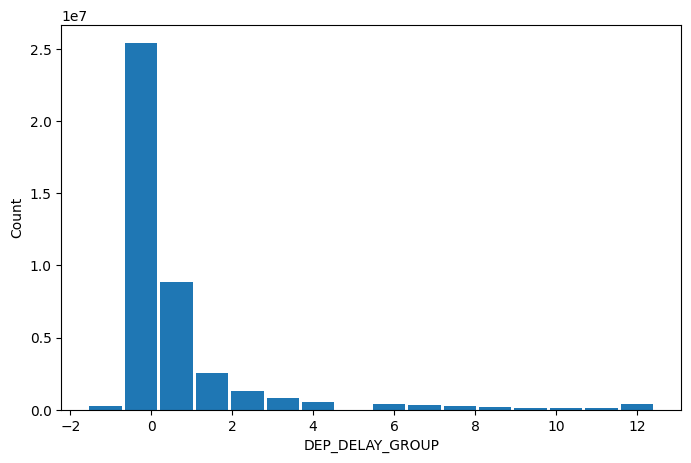

In [0]:
# The DEP_DELAY_GROUP field groups contain delay times by 15 minutes intervals.
n_buckets = len(df_flights_deduped.select("DEP_DELAY_GROUP").distinct().collect())
hist = df_flights_deduped.select("DEP_DELAY_GROUP").rdd.flatMap(lambda x: x).histogram(n_buckets)
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(x=hist[0][1:], height=hist[1])
ax.set_xlabel('DEP_DELAY_GROUP')
ax.set_ylabel('Count')

## 1.8 Airline Data - Delays based on Origin Airport and Airline Carrier 

In [0]:
# Top 10 popular Origin Airports
num_dep_delay = df_flights_deduped.select( 'ORIGIN','DEP_DEL15' ).groupBy('ORIGIN').agg(F.sum('DEP_DEL15')).withColumnRenamed('sum(DEP_DEL15)', 'Departure_Delays') 
df = num_dep_delay.toPandas()
df1_sort = df.sort_values(by='Departure_Delays', ascending=False)
origin_airport_top10 = df1_sort.head(10)

# Top 10 popular Destination Airports
num_dep_delay = df_flights_deduped.select( 'DEST','DEP_DEL15' ).groupBy('DEST').agg(F.sum('DEP_DEL15')).withColumnRenamed('sum(DEP_DEL15)', 'Departure_Delays') 
df = num_dep_delay.toPandas()
df2_sort = df.sort_values(by='Departure_Delays', ascending=False)
dest_airport_top10 = df2_sort.head(10)

# Top 10 Airline Carrier patterns
num_dep_delay = df_flights_deduped.select( 'OP_UNIQUE_CARRIER','DEP_DEL15' ).groupBy('OP_UNIQUE_CARRIER').agg(F.sum('DEP_DEL15')).withColumnRenamed('sum(DEP_DEL15)', 'Departure_Delays') 
df = num_dep_delay.toPandas()
df_sort = df.sort_values(by='Departure_Delays', ascending=False)
airline_carrier = df_sort.head(10)

[Text(0.2, 0, 'WN'),
 Text(1.2, 0, 'AA'),
 Text(2.2, 0, 'DL'),
 Text(3.2, 0, 'OO'),
 Text(4.2, 0, 'UA'),
 Text(5.2, 0, 'B6'),
 Text(6.2, 0, 'EV'),
 Text(7.2, 0, 'MQ'),
 Text(8.2, 0, 'NK'),
 Text(9.2, 0, 'AS')]

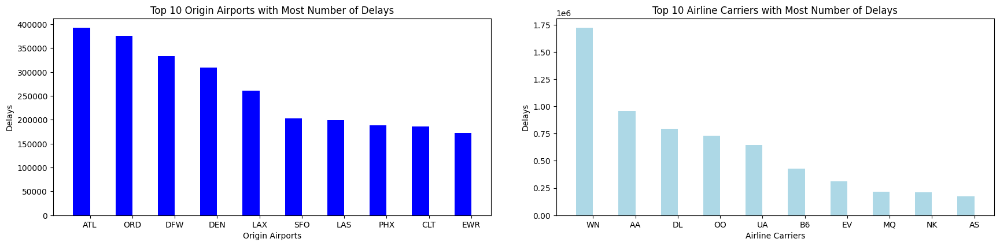

In [0]:
# Plot histograms for Top 10 Origin Airports and the Airline Carriers to depict departure delays
fig, ax = plt.subplots(1,2, figsize = (17, 4))
fig.tight_layout(h_pad=15, w_pad=5) 

# Origin Airports
x = np.arange(len(origin_airport_top10['ORIGIN'].unique()))
bar_width = 0.4

hist2 = ax[0].bar(x, origin_airport_top10['Departure_Delays'],
                width=bar_width, label='Departure_Delays', color='blue')
 
ax[0].set_xlabel("Origin Airports")
ax[0].set_ylabel("Delays")
ax[0].set_title("Top 10 Origin Airports with Most Number of Delays")
ax[0].set_xticks(x + bar_width / 2)
ax[0].set_xticklabels(origin_airport_top10['ORIGIN'].unique())

# Airline Carrier
x = np.arange(len(airline_carrier['OP_UNIQUE_CARRIER'].unique()))
bar_width = 0.4

hist1 = ax[1].bar(x, airline_carrier['Departure_Delays'],
                width=bar_width, label='Departure_Delays', color='lightblue')

ax[1].set_xlabel("Airline Carriers")
ax[1].set_ylabel("Delays")
ax[1].set_title("Top 10 Airline Carriers with Most Number of Delays")
ax[1].set_xticks(x + bar_width / 2)
ax[1].set_xticklabels(airline_carrier['OP_UNIQUE_CARRIER'].unique())


In [0]:
date_flight_count = df_flights_deduped.groupby("ORIGIN").pivot("FL_DATE").count().toPandas()
date_delay_count = df_flights_deduped.groupby("ORIGIN").pivot("FL_DATE").sum("DEP_DEL15").toPandas()
date_flight_count = date_flight_count.set_index("ORIGIN")
date_delay_count = date_delay_count.set_index("ORIGIN")
date_delay_rate = (date_delay_count.sum() / date_flight_count.sum()).sort_index()

In [0]:
display(date_delay_rate)

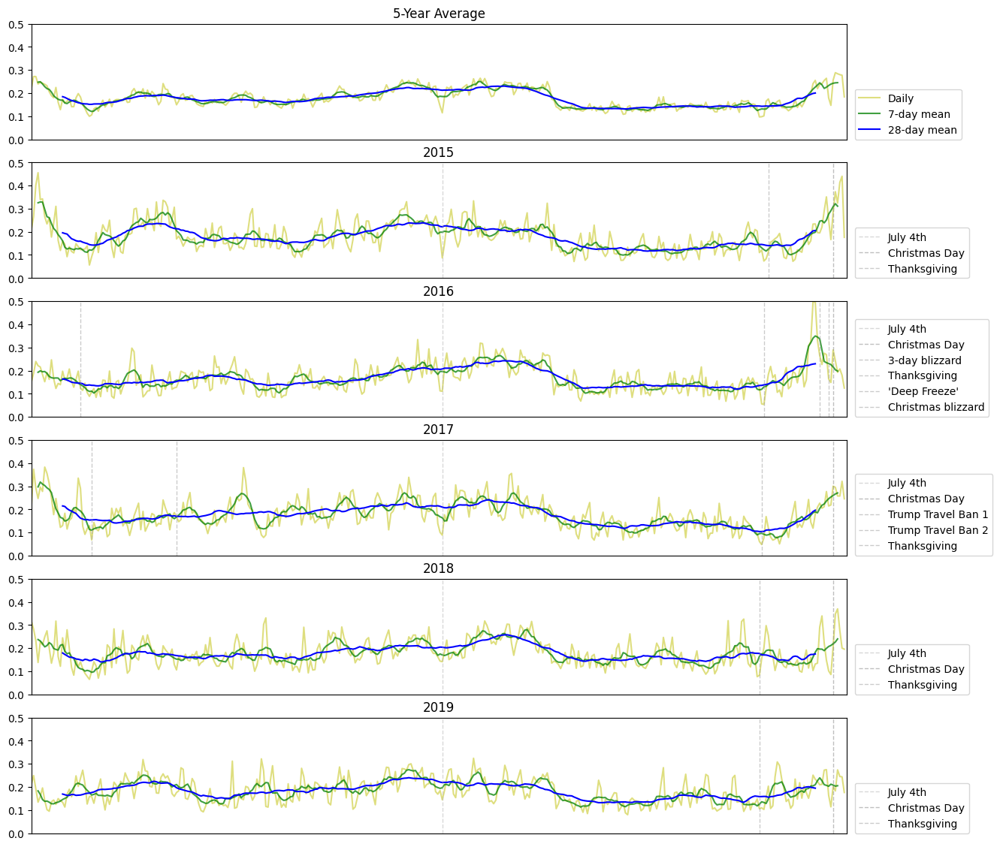

In [0]:
delay_date_by_year = dict()
for year in range(2015, 2020, 1):
  delay_date_by_year[year] = date_delay_rate[
    (date_delay_rate.index >= f"{year}-01-01") & 
    (date_delay_rate.index < f"{year+1}-01-01")
  ]
# Average Feb 28/29 and remove 29 date in leap year to make plots line up:
dr_2016 = delay_date_by_year[2016]
feb_28_29 = (dr_2016.loc["2016-02-28"] + dr_2016.loc["2016-02-29"]) / 2
dr_2016.loc["2016-02-28"] = feb_28_29
dr_2016 = dr_2016[dr_2016.index != "2016-02-29"]
delay_date_by_year[2016] = dr_2016
[len(v) for v in delay_date_by_year.values()]

# Date markers:
date_markers = {
  2015: {
    "Thanksgiving": 330,
  },
  2016: {
    "3-day blizzard": 22,
    "Thanksgiving": 328,
    "'Deep Freeze'": 353,
    "Christmas blizzard": 357,
  },
  2017: {
    "Trump Travel Ban 1": 27,
    "Trump Travel Ban 2": 65,
    "Thanksgiving": 327,
  },
  2018: {
    "Thanksgiving": 326,
  },
  2019: {
    "Thanksgiving": 326,
  },
}

# Create the plots:
fig, axes = plt.subplots(nrows=len(delay_date_by_year) + 1, figsize=(14, 14))

# Plot averages first:
mu = pd.Series(np.mean([v.values for v in delay_date_by_year.values()], axis=0))
ax = axes[0]
ax.set_title("5-Year Average")
ax.plot(mu.values, label="Daily", alpha=0.5, color="y")
rolling_week = mu.rolling(7, center=True).mean()
ax.plot(rolling_week, label="7-day mean", alpha=0.75, color="g")
rolling_week = mu.rolling(28, center=True).mean()
ax.plot(rolling_week, label="28-day mean", alpha=1, color="b")

ax.legend(loc=(1.01, 0))
ax.set_xticklabels([])
ax.set_xticks([])
ax.set_ylim(0, 0.5)
ax.set_xlim(0, 365)

# Plot individual years:
for i, (year, data) in enumerate(delay_date_by_year.items()):
  ax = axes[i+1]
  ax.set_title(f"{year}")
  ax.plot(data.values, alpha=0.5, color="y")
  rolling_week = data.rolling(7, center=True).mean()
  ax.plot(rolling_week, alpha=0.75, color="g")
  rolling_week = data.rolling(28, center=True).mean()
  ax.plot(rolling_week, alpha=1, color="b")
  ax.vlines(184, 0, 0.5, label="July 4th", color="#b3b3b3", 
            linestyle="--", lw=1, alpha=0.5)
  ax.vlines(359, 0, 0.5, label="Christmas Day", 
            color="#808080", linestyle="--", lw=1, alpha=0.5)
  
  for k, v in date_markers[year].items():
    ax.vlines(v, 0, 0.5, label=k, color="#999999", linestyle="--", lw=1, alpha=0.5)

  ax.legend(loc=(1.01, 0))
  ax.set_xticklabels([])
  ax.set_xticks([])
  ax.set_ylim(0, 0.5)
  ax.set_xlim(0, 365)

(0.0, 365.0)

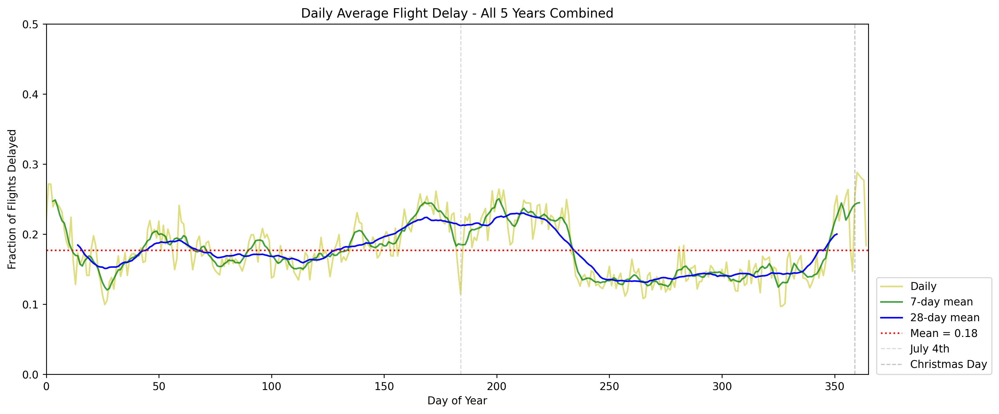

In [0]:
# Create the single average plot:
fig, ax = plt.subplots(figsize=(14, 6), dpi=250)

# Plot averages first:
mu = pd.Series(np.mean([v.values for v in delay_date_by_year.values()], axis=0))
ax.set_title("Daily Average Flight Delay - All 5 Years Combined")
ax.plot(mu.values, label="Daily", alpha=0.5, color="y")
rolling_week = mu.rolling(7, center=True).mean()
ax.plot(rolling_week, label="7-day mean", alpha=0.75, color="g")
rolling_week = mu.rolling(28, center=True).mean()
ax.plot(rolling_week, label="28-day mean", alpha=1, color="b")

# Mean:
total_mean = mu.mean()
ax.hlines(total_mean, 0, 365, label=f"Mean = {total_mean:.2f}", color="r", linestyle=":")

# Holidays:
ax.vlines(184, 0, 0.5, label="July 4th", color="#b3b3b3", 
          linestyle="--", lw=1, alpha=0.5)
ax.vlines(359, 0, 0.5, label="Christmas Day", 
          color="#808080", linestyle="--", lw=1, alpha=0.5)

# Labels:
ax.legend(loc=(1.01, 0))
ax.set_ylabel("Fraction of Flights Delayed")
ax.set_xlabel("Day of Year")
# ax.set_xticklabels([])
# ax.set_xticks([])
ax.set_ylim(0, 0.5)
ax.set_xlim(0, 365)

In [0]:
# Create day_of_week_del DataFrame
day_of_week_del = df_flights_deduped.select( 'DAY_OF_WEEK','DEP_DEL15' ).groupBy('DAY_OF_WEEK').agg(F.sum('DEP_DEL15')).withColumnRenamed('sum(DEP_DEL15)', 'Departure_Delays').toPandas()

# Create day_of_month_del DataFrame
day_of_month_del = df_flights_deduped.select( 'DAY_OF_MONTH','DEP_DEL15' ).groupBy('DAY_OF_MONTH').agg(F.sum('DEP_DEL15')).withColumnRenamed('sum(DEP_DEL15)', 'Departure_Delays').toPandas()

# Create quarter_del DataFrame
quarter_del = df_flights_deduped.select( 'QUARTER','DEP_DEL15' ).groupBy('QUARTER').agg(F.sum('DEP_DEL15')).withColumnRenamed('sum(DEP_DEL15)', 'Departure_Delays').toPandas()

# Create month_del DataFrame
month_del = df_flights_deduped.select( 'MONTH','DEP_DEL15' ).groupBy('MONTH').agg(F.sum('DEP_DEL15')).withColumnRenamed('sum(DEP_DEL15)', 'Departure_Delays').toPandas()


Text(0.5, 1.0, 'Departure Month of Year vs. Number of Departure Delays')

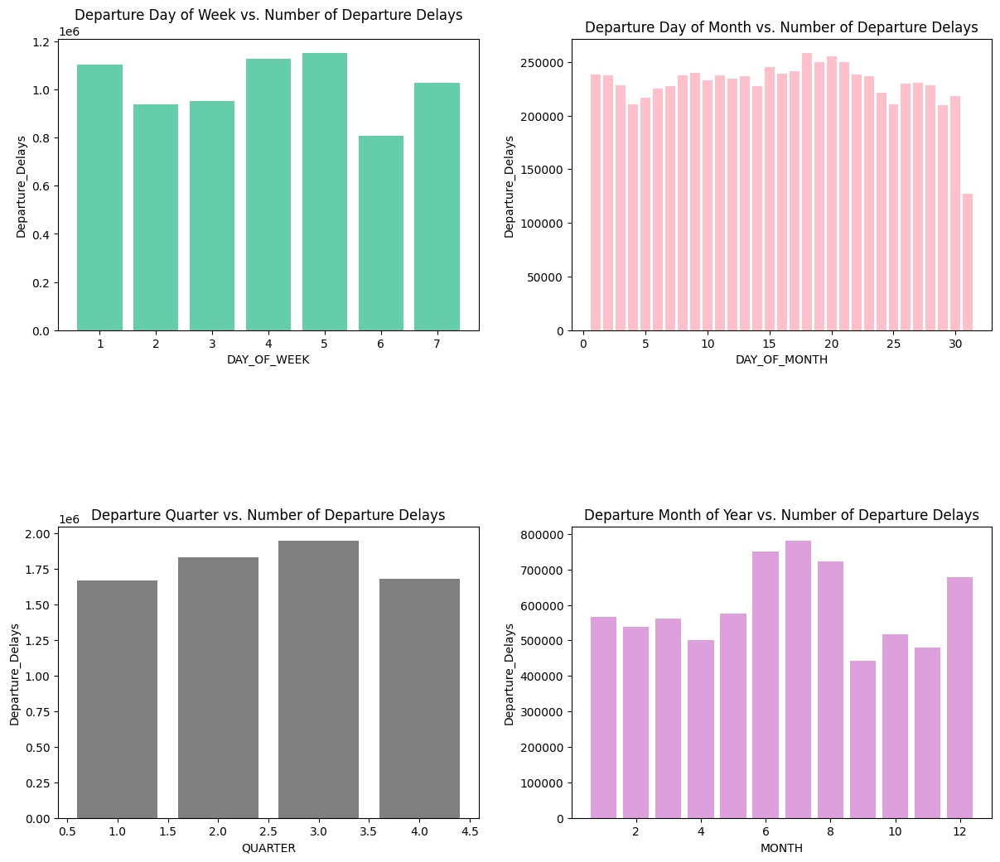

In [0]:
fig, ax = plt.subplots(2,2, figsize = (12, 10))
fig.tight_layout(h_pad=15, w_pad=5) 

ax[0][0].bar(day_of_week_del['DAY_OF_WEEK'] , day_of_week_del['Departure_Delays'],  
            label='Departure_Delays', color = 'mediumaquamarine')
ax[0][0].set_xlabel('DAY_OF_WEEK')
ax[0][0].set_ylabel('Departure_Delays')
ax[0][0].set_title('Departure Day of Week vs. Number of Departure Delays')

ax[0][1].bar(day_of_month_del['DAY_OF_MONTH'] , day_of_month_del['Departure_Delays'],  
            label='Departure_Delays', color = 'pink')
ax[0][1].set_xlabel('DAY_OF_MONTH')
ax[0][1].set_ylabel('Departure_Delays')
ax[0][1].set_title('Departure Day of Month vs. Number of Departure Delays')

ax[1][0].bar(quarter_del['QUARTER'] , quarter_del['Departure_Delays'],  
            label='Departure_Delays', color = 'grey' )
ax[1][0].set_xlabel('QUARTER')
ax[1][0].set_ylabel('Departure_Delays')
ax[1][0].set_title('Departure Quarter vs. Number of Departure Delays')

ax[1][1].bar(month_del['MONTH'] , month_del['Departure_Delays'],  
            label='Departure_Delays', color = 'plum')
ax[1][1].set_xlabel('MONTH')
ax[1][1].set_ylabel('Departure_Delays')
ax[1][1].set_title('Departure Month of Year vs. Number of Departure Delays')
     

/databricks/python/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


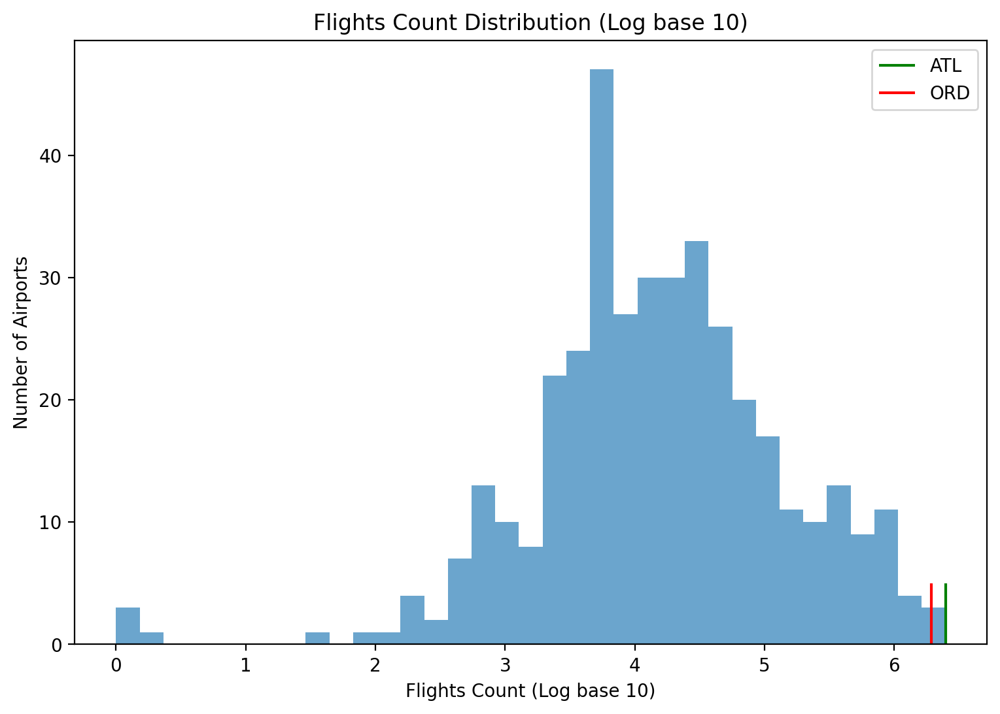

In [0]:
# Get the count of flights by airport:
origin_count = df_flights_deduped.groupby("ORIGIN").count().toPandas()
dest_count = df_flights_deduped.groupby("DEST").count().toPandas()

flight_counts = pd.merge(
  origin_count.rename(columns={"count": "origin_count"}), 
  dest_count.rename(columns={"count": "dest_count"}),
  left_on="ORIGIN", 
  right_on="DEST", 
  how="outer"
).sort_values(by=["origin_count", "dest_count"], ascending=False)
flight_counts["origin_count"] = flight_counts["origin_count"].fillna(0).astype(int)
flight_counts["dest_count"] = flight_counts["dest_count"].fillna(0).astype(int)

# Merge in the count of delayed flights by airport:
origin_delay_count = df_flights_deduped.groupby("ORIGIN").sum("DEP_DEL15").toPandas()
origin_delay_count = origin_delay_count.rename(columns={"sum(DEP_DEL15)": "num_delays"})
flight_counts = pd.merge(flight_counts, origin_delay_count, on="ORIGIN", how="left")
flight_counts["num_delays"] = flight_counts["num_delays"].fillna(0).astype(int)
flight_counts["proportion_delayed"] = flight_counts["num_delays"] / flight_counts["origin_count"]

# Add log-10 of number of flights for plotting:
flight_counts["log_10_origin_count"] = np.log(flight_counts["origin_count"]) / np.log(10)

# Drop airports which were only destinations:
flight_counts = flight_counts[flight_counts["origin_count"] > 0]

# Data series for Atlanta and Chicago airports:
atl = flight_counts.set_index("ORIGIN").loc["ATL"]
ord = flight_counts.set_index("ORIGIN").loc["ORD"]

# Histogram of log-10 number of flights by airport:
fig, ax = plt.subplots(figsize=(9, 6), dpi=200)
ax.hist(flight_counts["log_10_origin_count"], bins=35, alpha=.66)
ax.set_ylabel(f"Number of Airports")
ax.set_xlabel("Flights Count (Log base 10)")
ax.vlines(atl["log_10_origin_count"], 0, 5, color="g", label="ATL")
ax.vlines(ord["log_10_origin_count"], 0, 5, color="r", label="ORD")
ax.legend()
ax.set_title("Flights Count Distribution (Log base 10)")
plt.show()
     

Uploading artifacts:   0%|          | 0/5 [00:00<?, ?it/s]

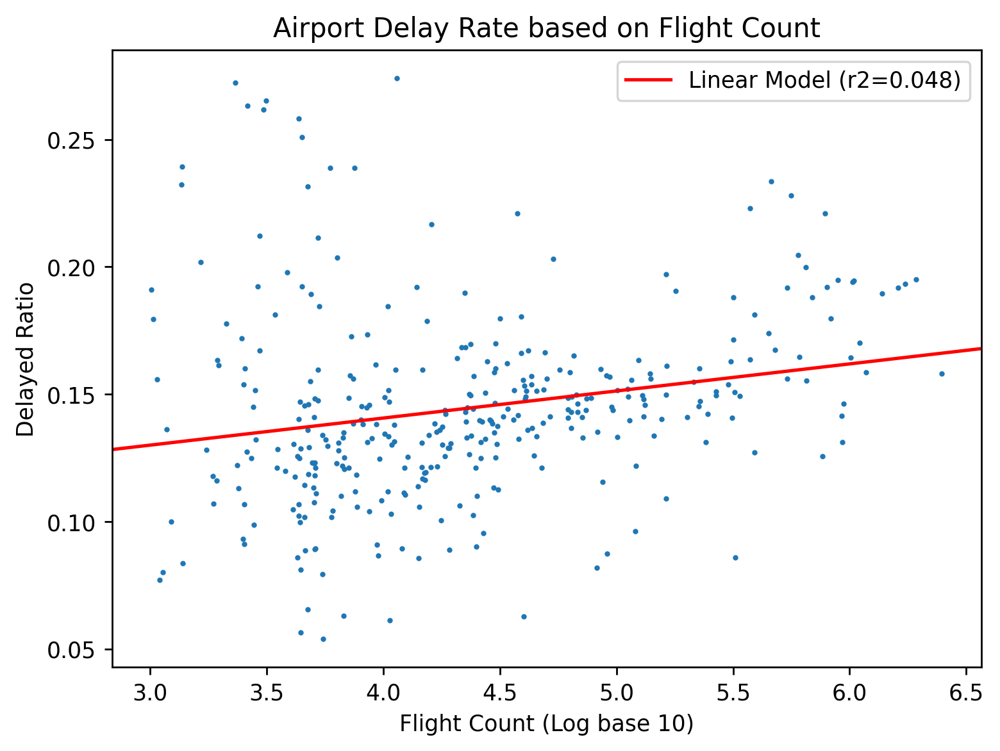

In [0]:

# Plot of log-10 number of flights by airport:
subset = flight_counts[flight_counts["origin_count"] > 1000]
fig, ax = plt.subplots(figsize=(7, 5), dpi=250)
ax.scatter(subset["log_10_origin_count"], subset["proportion_delayed"], s=2)
ax.set_xlabel(f"Flight Count (Log base 10)")
ax.set_ylabel("Delayed Ratio")

# Fit a model and plot the line:
from sklearn.linear_model import LinearRegression
model = LinearRegression(fit_intercept=True)
model.fit(subset[["log_10_origin_count"]], subset["proportion_delayed"])
r2 = model.score(subset[["log_10_origin_count"]], subset["proportion_delayed"])
x_min, x_max = ax.get_xlim()
y_min = model.coef_[0] * x_min + model.intercept_
y_max = model.coef_[0] * x_max + model.intercept_
ax.plot([x_min, x_max],  [y_min, y_max], color="r", label=f"Linear Model (r2={r2:.3f})")
ax.set_xlim(x_min, x_max)
ax.legend()
ax.set_title("Airport Delay Rate based on Flight Count")
plt.show()

# 2. Weather Dataset - EDA

## 2.1 Weather Data - Peek into the data

In [0]:
# Weather data
df_weather = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data/")
display(df_weather)

In [0]:
from pyspark.sql.functions import col, count, lit

total_count = df_weather.count()
non_null_counts = df_weather.select([count(c).alias(c) for c in df_weather.columns])
non_null_rates = non_null_counts.select([(col(c) / lit(total_count)).alias(c) for c in non_null_counts.columns])
non_null_rates.show()

com.databricks.backend.common.rpc.CommandCancelledException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:103)
	at scala.Option.getOrElse(Option.scala:189)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$2(SequenceExecutionState.scala:103)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$2$adapted(SequenceExecutionState.scala:100)
	at scala.collection.immutable.Range.foreach(Range.scala:158)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:100)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:714)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:430)
	at scala.Option.getOrElse(Option.scala:189)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:430)
	at com.databricks.spark.chauffeur.ChauffeurState.cancelExecutio

In [0]:
non_null_counts_dict = non_null_counts.collect()[0].asDict()

columns_to_keep = [c for c, cnt in non_null_counts_dict.items() if (cnt / total_count) > 0.5]
columns_to_keep

['STATION',
 'DATE',
 'LATITUDE',
 'LONGITUDE',
 'ELEVATION',
 'NAME',
 'REPORT_TYPE',
 'SOURCE',
 'HourlyAltimeterSetting',
 'HourlyDewPointTemperature',
 'HourlyDryBulbTemperature',
 'HourlyRelativeHumidity',
 'HourlyStationPressure',
 'HourlyVisibility',
 'HourlyWetBulbTemperature',
 'HourlyWindDirection',
 'HourlyWindSpeed',
 'REM',
 'YEAR']

## 2.2 Weather Data - Look for Duplicates

In [0]:
# Check for duplicates in Weather data
print("Total records count without duplicates:", df_weather.count())
df_weather_deduped = df_weather.dropDuplicates()
num_records_df_weather_deduped = df_weather_deduped.count()
print("Total records count after dropping duplicates:", num_records_df_weather_deduped)

# Total 30,528,602 records - the data looks good and it does not have any duplicates.

## 2.3 Weather Data - Summarize after duplicates(if any) clean-up

In [0]:
# Summary of weather data
display(df_weather_deduped.describe())

## 2.4 Weather Data - Unique Weather Stations

In [0]:
# Number of Unique Weather Stations
# display(df_weather_deduped.select("STATION").distinct())
num_unique_weather_stations = df_weather_deduped.select("STATION").distinct().count()
print("Total Number of Unique Weather Stations:", num_unique_weather_stations)

## 2.5 Weather Data - Date Range of Available Data

In [0]:
min_date_weather =df_weather_deduped.select(F.min(F.col("DATE")).alias("MIN")).limit(1).collect()[0].MIN
max_date_weather =df_weather_deduped.select(F.max(F.col("DATE")).alias("MAX")).limit(1).collect()[0].MAX
print(f"Earliest Date of recorded weather: {min_date_weather}")
print(f"Latest date of recorded weather: {max_date_weather}")

In [0]:
# Creating a dictionary with the information
weather_info = {
    "Metric": ["Total Weather Records", "Number of Unique Weather Stations", "Earliest Date of recorded weather", "Latest Date of recorded weather"],
    "Value": [num_records_df_weather_deduped, num_unique_weather_stations, pd.to_datetime(min_date_weather).strftime('%Y-%m-%d'), pd.to_datetime(max_date_weather).strftime('%Y-%m-%d')]
}

# Creating a DataFrame from the dictionary
weather_info_df = pd.DataFrame(weather_info)

# Displaying the DataFrame
weather_info_df

## 2.6 Weather Data - NULL/Empty values

In [0]:
null_count={}
for field in df_weather_deduped.columns:
  null_count[field]=df_weather_deduped.select(field).where(F.col(field)=='').count()

In [0]:
percent_coverage  = (100 - 100* pd.DataFrame([null_count])/df_weather_deduped.count())

## 2.7 Weather Data - Feature vs Coverage

In [0]:
p=percent_coverage.T.values
plt.plot(p,'r+')
plt.title(' Data availability by Feature ',fontsize=15)
plt.xlabel('Feature',fontsize=12)
plt.ylabel('% Coverage', fontsize=12)
plt.rcParams["figure.figsize"] = [18,6]

In [0]:
## Filter for non Sparse fields
non_sparse = percent_coverage.T.reset_index().rename_axis(None).rename_axis(None, axis=1)
non_sparse = non_sparse.rename(columns = {'index':'Field'})
non_sparse.rename( columns={0 :'Coverage'}, inplace=True )
non_sparse[non_sparse.Coverage>90]

# 3. Combined Dataset - EDA

In [0]:
df_otpw_12m = spark.read.option("header", "true").option("compression", "gzip").csv(f"{data_BASE_DIR}/OTPW_12M/OTPW_12M_2015.csv.gz")
display(df_otpw_12m)


QUARTER,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,YEAR,MONTH,origin_airport_name,origin_station_name,origin_station_id,origin_iata_code,origin_icao,origin_type,origin_region,origin_station_lat,origin_station_lon,origin_airport_lat,origin_airport_lon,origin_station_dis,dest_airport_name,dest_station_name,dest_station_id,dest_iata_code,dest_icao,dest_type,dest_region,dest_station_lat,dest_station_lon,dest_airport_lat,dest_airport_lon,dest_station_dis,sched_depart_date_time,sched_depart_date_time_UTC,four_hours_prior_depart_UTC,two_hours_prior_depart_UTC,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPrecipitat

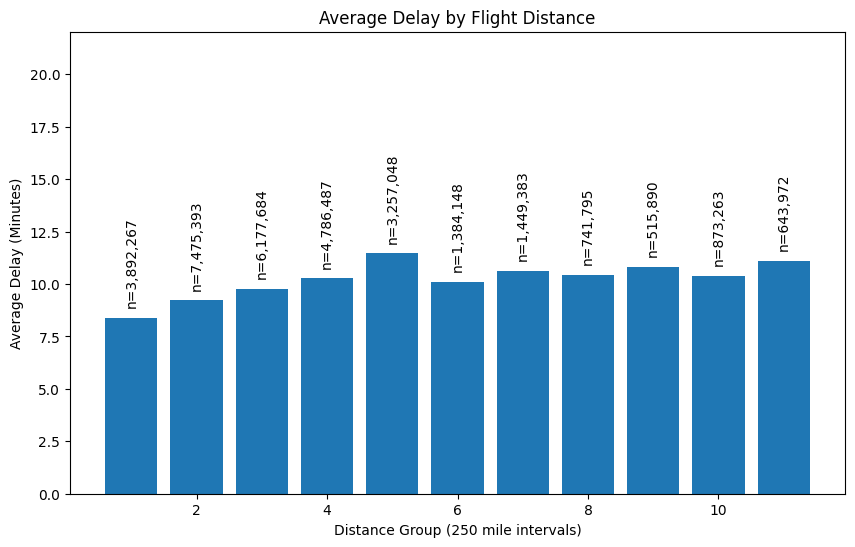

In [0]:
# Delay by Flight Distance
distance_delay = df_otpw_60m.select("DISTANCE_GROUP", "DEP_DELAY")\
                           .groupby("DISTANCE_GROUP")\
                           .agg(mean("DEP_DELAY"), count("DEP_DELAY"))\
                           .sort("DISTANCE_GROUP")\
                           .collect()
distance_df = pd.DataFrame(distance_delay, columns=["DISTANCE_GROUP", "AVG_DELAY", "N"])
fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(distance_df["DISTANCE_GROUP"], height=distance_df["AVG_DELAY"])
ax.set_xlabel("Distance Group (250 mile intervals)")
ax.set_ylabel("Average Delay (Minutes)")
ax.set_title("Average Delay by Flight Distance")
for i, row in distance_df.iterrows():
  group, delay, n = row["DISTANCE_GROUP"], row["AVG_DELAY"]+0.5, f"n={row['N']:,.0f}"
  ax.text(group, delay, n, ha="center", va="bottom", rotation=90)
ax.set_ylim(0, ax.get_ylim()[1]+10)
plt.show()